## Assignment for EE5731 AY2023/2024 Semester 2
### Exploring Edge and Corner Detection from Ultra-dark Images and Finding Epipolar Lines from Stereo Image Pairs (100)

#### Background
While understanding of vision information through computer vision techniques have been developed (and still developing) over the past decades, current techniques may not be applied directly to real-world applications due to various constraints. One of the concerns is that current techniques are mainly developed assuming the input data are shot under a non-challenging environment, with adequate illumination and contrast. This leads to the observable fragility of current techniques, which may not be capable to generalize well to adverse environments, including dark environments with low illumination. Take security surveillance as an example: obtaining crucial visual information such as edges and corners could play a vital role in detecting objects for anomaly detection. However, anomalies are more common at nighttime and in dark environments, yet current computer vision approaches are largely obscured by darkness, and are unable to extract key visual information effectively. It is therefore highly desirable to explore how we could obtain visual information given the current computer vision approaches in ultra-dark images.

#### Requirements
In this assignment, you are to complete several tasks that explores ways to obtain edges and corners from ultra-dark images, and to find epipolar lines from stereo dark image pairs.

Before doing the project, please read the instructions carefully (failure to follow them may result in unnecessary penalty):

1. Implement your codes with the code block in jupyter notebook, you may add in however much code blocks you require. TODO code blocks are added as placeholders. **DO NOT** modify the instructional markdown blocks;
2. Make sure your codes **clean**, **easily readable** (add meaningful comments if needed, comments are **markable**);
3. Make sure that the **submitted notebooks have been run** and the **cell outputs are clearly visible**.
4. Write your answers in the given markdown cells (with [**Fill in xxxx**]), keep your answers clear and concise;
5. Your submission should be the exported PDF file of your jupyter notebook. It is easier for you to **"Export to HTML"** first, then **Print to PDF**. Please print your PDF strictly in **Portrait** mode. Name your PDF file strictly to **"MATRICULATION NUMBER_YOUR NAME_CA1.pdf"**
6. Incorrect submission format will result in a **direct** 20 points (out of 100) deduction.
6. Do submit your project on [Canvas](https://canvas.nus.edu.sg/) before the deadline: **5:59 pm (SGT), 4 October, 2024**; 
7. Policy on late submission: the deadline is a strict one, so please prepare and plan early and carefully. Any late submission will be deducted 10 points (out of 100) for every 24 hours.
8. This is an individual project, do **NOT** share your solutions with others, we have zero tolerance for **plagiarism**.

#### Before Task 1
- For the following task, you are to use [Pic1](https://canvas.nus.edu.sg/files/4601735/download?download_frd=1) as the ultra-dark image (denote as Dark-1). The corresponding long-exposure normal brightness image is [GT1](https://canvas.nus.edu.sg/files/4601732/download?download_frd=1) (denote as Bright-1).
- All raw images are given in RGB format (colored images), but you may also convert to grayscale images for your convenience. Show the step and result of grayscale conversion first if you are to convert to grayscale for your tasks.
- **IMPORTANT!** You may use any function of OpenCV or its equivalence for basic operations (e.g., loading images, matrix computation, etc.), but **strictly NOT** the direct functions for each individual task/step (e.g., cv.Canny or its equivalence for Canny edge detection, and cv.equalizeHist for histogram equalization). Using such functions would consider the code to be erroneous.

#### Task 1: Canny edge detection and Harris corener detection in ultra-dark images (60%)
In this task, you will need to implement the Canny edge detection algorithm and try to improve its performance with image enhancement methods. You are to discuss how the characteristics of ultra-dark images affect the performance of Canny edge detection, and how different image enhancement methods would improve/affect the performance of Canny edge detection on ultra-dark images. You are to follow the following steps (requirements):

##### Detailed Steps/Requirements for Task 1:
1. Compute the image histograms of both Dark-1 and Bright-1, then discuss your observations, what is the characteristics of an ultra-dark image and how it is observed through the image histograms. (10%)
2. Perform Canny edge detection on both Dark-1 and Bright-1. For **at least one of the images**, show the output of every single key step of Canny edge detection (e.g., after image smoothing, after computing partial derivatives, after applying threshold, etc.) as well as the final output. Observe and compare the performances of Canny edge detection on Dark-1 and Bright-1 and discuss why you would observe your result. (10%)
3. Perform Harris corner detector detection on both Dark-1 and Bright-1. For **at least one of the images**, show the output of every single key step of Harris corner detector detection as well as the final output. Observe and compare the performances of Harris corner detector detection on Dark-1 and Bright-1 and discuss why you would observe your result. (10%)
4. Implement **histogram equalization (HE)** from scratch to Dark-1. Output the results of HE (denote as Dark-1-HE) and discuss your observation: how HE change/improve the sampled images. Hypothesize how will the output of Canny edge detection and Harris corner detection be like for Dark-1-HE. (10%)
5. Apply your implementation of Canny edge detection and Harris corner detection onto your HE-enhanced sampled images and demonstrate the final output. Do the final outputs fit your hypothesis? If yes, rationalize your hypothsis. If not, describe and explain the differences. Also discuss how are the results compared to that of Bright-1? (10%)
6. Lastly, choose a image enhancement method you prefer. **State** what image enhancement method has been chosen. Implement it with **appropriate comments** and output the results (denote as Dark-1-Self). Apply Canny edge detection and Harris corner detection onto Dark-1-Self and display the results. Discuss the differences between the Dark-1-Self against Dark-1-HE. Further, observe, compare, and rationalize the difference between the edges and corners detected between Dark-1, Dark-1-HE, Dark-1-Self, and Bright-1. (10%)
- *Note for Step 6: you may use open-source codes or direct functions in OpenCV or equivalent for the chosen image enhancement method.*

<mark><big>Notice:</big> </mark><br>
1. This program will create 2 new folders in the local relative path to store the original images and results, which will have **clearer** pictures of the images. The images displayed by **matplotlib** may be blurry, if you need to see the details, you can check the **result images** in the `./res_img` path. <br>
2. In addition, this program will read the 3 **original images** from the `./ori_img`: **GT1.jpg, GT2.jpg and Pic1.jpg**.

##### **Step 1: Compute the image histograms of Dark-1 and Bright-1**
The image histogram is the number of pixels in the image with a particular brightness(or intensity). Consider a discrete grayscale image $\{x\}$ and let $n_i$ be the number of occurrences of gray level $i$.
$${\displaystyle\ Hist_{x}(i)=n_{i},\quad 0\leq i<L}$$

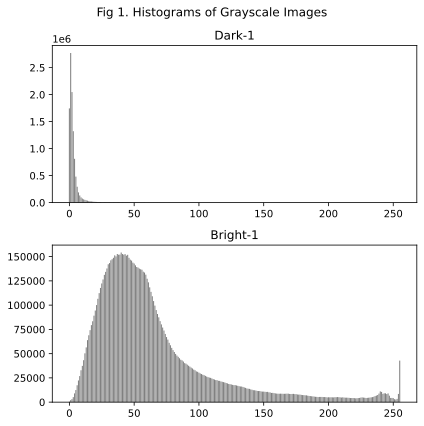

In [1]:
#############################################################################
##                                                                         ##
##           TODO: CODE BLOCK FOR STEP 1 IS HERE                           ##
#############################################################################
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

#Step 1. Histograms of both images
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import os
path_in = './ori_img'
if not os.path.exists(path_in):
    os.makedirs(path_in)
path_out = './res_img'
if not os.path.exists(path_out):
    os.makedirs(path_out)

# 1. read images:[image size:2656, 3984, 3]
img_dark = cv.imread('ori_img/Pic1.jpg')
img_bright = cv.imread('ori_img/GT1.jpg')

# 2. convert RGB format to grayscale:
gray_bright = cv.cvtColor(src=img_bright, code=cv.COLOR_BGR2GRAY)
gray_dark = cv.cvtColor(src=img_dark, code=cv.COLOR_BGR2GRAY)

# 3. save grayscale image for following steps:
cv.imwrite('res_img/Pic1_G.png', gray_dark)
cv.imwrite('res_img/GT1_G.png', gray_bright)

# 4. calculate the histogram of grayscale images:
# define the histogram calculator:
def calc_hist(img_gray):
    # Assuming img_gray is already a grayscale image
    y = np.zeros((256), np.uint64)
    im_array = np.array(img_gray, dtype=np.uint8)  # Ensure correct data type
    for i in np.nditer(im_array):
        y[int(i)] += 1
    return y

y_dark = calc_hist(gray_dark)
y_bright = calc_hist(gray_bright)

# 5. show histograms in bar graph:
x = np.arange(0, 256)
fig, ax = plt.subplots(2, 1, figsize=(6, 6))
fig.suptitle('Fig 1. Histograms of Grayscale Images', size = 12)
ax[0].bar(x,y_dark,color="gray",align="center")
ax[0].set_title('Dark-1')
ax[1].bar(x,y_bright,color="gray",align="center")
ax[1].set_title('Bright-1')
plt.tight_layout() # prevent overlapping

[**Fill in your discussion to Step 1 here**]

<big>**Discussion:**</big>

**1. Characteristics of ultra-dark pictures:**<br>
(1)Most of the pixels have **low-intensity** values, which causes the picture to look dark overall.<br>
(2)**Low contrast:** meaning that the variation of intensity is relatively small.<br>
(3)**Lack of details:** details are hard to extract by the naked eye.<br>
(4)**Noticeable noise** exists in ultra-dark parts, which seems like graininess.

**2. Observation through image histograms:**<br>
&emsp;Since most of the pixels have low intensity and low contrast, the histogram will have a magnificent sharp peak near the **lower end** of the grayscale value(left end, close to 0, which represents the dark pixel). On the other hand, the rest of the grayscale values in histograms will be **almost empty**. Few pixels with middle brightness values imply that the naked eye **cannot tell details** or extract information from ultra-dark pictures. Unfortunately, the characteristic of **noise** may not be observed through the histogram. The essence of a histogram is to **count** the number of pixels occupied by grayscale values, so it cannot reflect the subtle **changes between pixels**. Due to the low intensity, even though there is a lot of noise, their variation in intensity value can be extremely small.

##### **Step 2: Perform Canny edge detection on both Dark-1 and Bright-1**

The Canny edge detection algorithm is composed of 5 steps:<br>
(1) Noise reduction(Gaussian Blur);<br>
(2) Gradient calculation(Sobel kernel filtering);<br>
(3) Non-maximum suppression;<br>
(4) Double threshold;<br>
(5) Edge Tracking by Hysteresis.<br>

I will use grayscale image in this part:

/var/folders/6x/w4vd6dz97bg0d1jlg5pf0xcr0000gn/T/ipykernel_25299/2259337201.py:98: RuntimeWarning: invalid value encountered in double_scalars
  x_est = np.abs(Gy[i,j]/Gmag[i,j]) # y


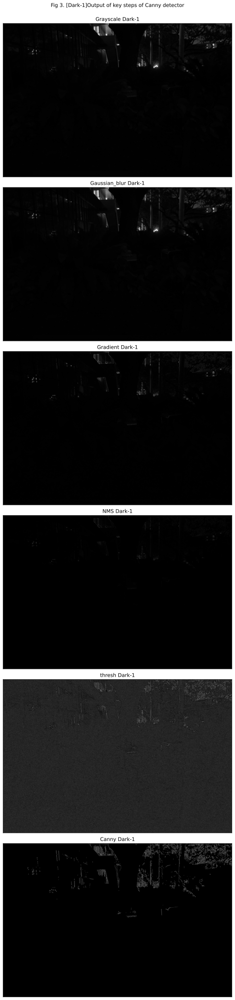

In [2]:
#############################################################################
##                                                                         ##
##           TODO: CODE BLOCK FOR STEP 2 IS HERE                           ##
#############################################################################

#Step 2. Perform Canny edge detection (using grayscale image)
from scipy import signal
import matplotlib.pyplot as plt

# Read images and convert to grayscale:
gray_b = cv.imread('res_img/GT1_G.png', cv.IMREAD_GRAYSCALE)
gray_d = cv.imread('res_img/Pic1_G.png', cv.IMREAD_GRAYSCALE)

# 2.1 Noise reduction by Gaussian blur(image convolution with 5X5 Gaussian Kernel) 
# Generate 5x5 Gaussian kernel:
def gaussian_kernel(k_size = 5, sigma = 1):
    k_size = int(k_size) // 2
    x, y = np.mgrid[-k_size:k_size+1, -k_size:k_size+1]
    normal = 1 / (2.0 * np.pi * sigma**2)
    g = np.exp(-(x**2+y**2)/(2*sigma**2))*normal
    return g
g_kernel = gaussian_kernel(5, 1)

# Apply convolution:
blur_b = signal.convolve2d(gray_b, g_kernel, boundary='symm', mode='same')
blur_d = signal.convolve2d(gray_d, g_kernel, boundary='symm', mode='same')

# 2.2 Gradient calculation by applying Sobel filter
# Define Sobel kernels Kx, Ky
Kx = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
Ky = Kx.T

def sobel_filter(img):
    # Compute first derivatives Ix, Iy
    Ix = signal.convolve2d(img, Kx, boundary='symm', mode = 'same')
    Iy = signal.convolve2d(img, Ky, boundary='symm', mode = 'same')
    # Compute magnitude and direction
    G = np.hypot(Ix, Iy)
    G = G / G.max() * 255
    theta = np.arctan2(Iy, Ix)
    return G, theta, Ix, Iy

gradient_b, theta_b, Gx_b, Gy_b = sobel_filter(blur_b)
gradient_d, theta_d, Gx_d, Gy_d = sobel_filter(blur_d)

# 2.3 Non-maximum suppression

# non-maximum suppression (no-interpolation version)
# def non_maximum_suppression(image,direction):
#     row, column = image.shape
#     res = np.zeros((row, column), dtype=np.uint8)
#     angle = direction * 180. / np.pi
#     angle[angle < 0] += 180
#     for i in range(0, row-1):
#         for j in range(0, column-1):
#             try:
#                 m = 255
#                 n = 255
#                 # degree 0
#                 if(0<=angle[i,j]<22.5)or(157.5<=angle[i,j]<180):
#                     m=image[i, j+1]
#                     n=image[i, j-1]
#                 # degree 45
#                 elif(22.5<=angle[i,j]<67.5):
#                     m=image[i-1,j+1]
#                     n=image[i+1,j-1]
#                 # degree 90
#                 elif(67.5<=angle[i,j]<112.5):
#                     m=image[i+1,j]
#                     n=image[i-1,j]
#                 #degree 135
#                 elif(112.5<=angle[i,j]<157.5):
#                     m=image[i-1,j-1]
#                     n=image[i+1,j+1]
#                 if(image[i,j] >= m) and (image[i,j] >= n):
#                     res[i,j] = image[i,j]
#                 else:
#                     res[i,j] = 0
#             except IndexError as e:
#                 pass
#     return res
# nms_b = non_maximum_suppression(gradient_b, theta_b)
# nms_d = non_maximum_suppression(gradient_d, theta_d)

# Perform non-maximum suppression using interpolation
def non_maximum_suppression(Gmag, angle, Gx, Gy):
    h,w = Gmag.shape
    angle = angle * 180. / np.pi
    X=np.array([[-1, 0, 1],[-1,0,1],[-1,0,1]],np.float32)
    Y=np.array([[-1,-1,-1],[ 0,0,0],[ 1,1,1]],np.float32)
    output = np.zeros((h,w), dtype = np.float32)
    x = np.array([0,1], np.float32)
    for i in range(1,h-1): # row
        for j in range(1,w-1): # col
            if (0<=angle[i,j]<=45 or -180<=angle[i,j]<-135):
                yBot = np.array([Gmag[i,j+1],Gmag[i+1,j+1]], np.float32)
                yTop = np.array([Gmag[i,j-1],Gmag[i-1,j-1]], np.float32)
                x_est = np.abs(Gy[i,j]/Gmag[i,j]) # y
                if (Gmag[i,j] >= ((yBot[1]-yBot[0])*x_est+yBot[0])) and \
                    (Gmag[i,j]>= ((yTop[1]-yTop[0])*x_est+yTop[0])):
                    output[i,j]= Gmag[i,j]
                else:
                    output[i,j]=0
            elif (45<angle[i,j]<=90 or -135<=angle[i,j]<-90):
                yBot = np.array([Gmag[i+1,j],Gmag[i+1,j+1]], np.float32)
                yTop = np.array([Gmag[i-1,j],Gmag[i-1,j-1]], np.float32)
                x_est = np.abs(Gx[i,j]/Gmag[i,j])
                if (Gmag[i,j] >= ((yBot[1]-yBot[0])*x_est+yBot[0]) and \
                    Gmag[i,j] >= ((yTop[1]-yTop[0])*x_est+yTop[0])):
                    output[i,j]= Gmag[i,j]
                else:
                    output[i,j]=0
            elif (90<angle[i,j]<=135 or -90<=angle[i,j]<-45 ):
                yBot = np.array([Gmag[i+1,j],Gmag[i+1,j-1]], np.float32)
                yTop = np.array([Gmag[i-1,j],Gmag[i-1,j+1]], np.float32)
                x_est = np.abs(Gx[i,j]/Gmag[i,j])
                if (Gmag[i,j] >= ((yBot[1]-yBot[0])*x_est+yBot[0]) and\
                    Gmag[i,j] >= ((yTop[1]-yTop[0])*x_est+yTop[0])):
                    output[i,j]= Gmag[i,j]
                else:
                    output[i,j]=0
            elif (135<angle[i,j]<=180 or -45<=angle[i,j]<0 ):
                yBot = np.array([Gmag[i,j-1],Gmag[i+1,j-1]], np.float32)
                yTop = np.array([Gmag[i,j+1],Gmag[i-1,j+1]], np.float32)
                x_est = np.abs(Gx[i,j]/Gmag[i,j])
                if (Gmag[i,j] >= ((yBot[1]-yBot[0])*x_est+yBot[0]) and\
                    Gmag[i,j] >= ((yTop[1]-yTop[0])*x_est+yTop[0])):
                    output[i,j]= Gmag[i,j]
                else:
                    output[i,j]=0
    Gmag = output/output.max()*255
    # plt.imshow(Gmag),plt.title('Non Maximum Suppression'),plt.show()
    # cv.imwrite('res_img/non_maximum_suppression.png',Gmag)
    return Gmag


nms_b = non_maximum_suppression(gradient_b, theta_b, Gx_b, Gy_b)
nms_d = non_maximum_suppression(gradient_d, theta_d, Gx_d, Gy_d)

# 2.4 double threshold
def double_threshold(img, low_thresh_ratio = 0.05, high_thresh_ratio = 0.15):
    highThreshold = img.max() * high_thresh_ratio
    lowThreshold = highThreshold * low_thresh_ratio
    # Initialize the output image (set 0)
    row,col = img.shape
    res = np.zeros((row, col), dtype=np.uint8)
    # Smaller than low threshold: set 0, 
    # Larger than high threshold: set 255
    # Between 2 thresholds: set 25
    weak = np.uint8(100)
    strong = np.uint8(255)
    strong_i, strong_j = np.where(img >= highThreshold)
    # zeros_i, zeros_j = np.where(img < lowThreshold)
    weak_i, weak_j = np.where((img <= highThreshold) & (img >= lowThreshold))
    res[strong_i, strong_j] = strong
    res[weak_i, weak_j] = weak
    return res

thresh_b = double_threshold(nms_b, 0.002, 0.15)
thresh_b_bp = thresh_b.copy()
thresh_d = double_threshold(nms_d, 0.002, 0.05)
thresh_d_bp = thresh_d.copy()

# 2.5 Edge Tracking by Hysteresis
def hysteresis(img, weak=100, strong=255):
    M, N = img.shape
    for x in range(1, M-1):
        for y in range(1, N-1):
            if (img[x,y] == weak):
                try:
                    # check strong point within 8-Neighborhood:
                    neighbors = np.delete(img[x-1:x+2,y-1:y+2].flatten(), 4)
                    if (strong in neighbors):
                        img[x, y] = strong
                    else:
                        img[x, y] = 0
                except IndexError as e:
                    pass
    return img

canny_res_b = hysteresis(thresh_b)
canny_res_d = hysteresis(thresh_d)

# Save result
cv.imwrite('res_img/Bright-1.png', gray_b)
cv.imwrite('res_img/Bright-1-Canny.png', canny_res_b)
cv.imwrite('res_img/Dark-1.png', gray_d)
cv.imwrite('res_img/Dark-1-Canny.png', canny_res_d)

# show the output of each step
fixed_width = 8
height, width = gray_b.shape
aspect_ratio = height / width 
fig_height = (fixed_width * aspect_ratio * 6)*1.04

fig, ax = plt.subplots(6, 1, figsize=(fixed_width,fig_height))
fig.suptitle('Fig 2. [Bright-1]Output of key steps of Canny detector', size = 12)
ax[0].imshow(gray_b, cmap='gray'),        ax[0].set_title('Grayscale Bright-1')
ax[1].imshow(blur_b, cmap='gray'),        ax[1].set_title('Gaussian_blur Bright-1')
ax[2].imshow(gradient_b, cmap='gray'),    ax[2].set_title('Gradient Bright-1')
ax[3].imshow(nms_b,cmap ='gray'),         ax[3].set_title('NMS Bright-1')
ax[4].imshow(thresh_b_bp,cmap ='gray'),   ax[4].set_title('thresh Bright-1')
ax[5].imshow(canny_res_b, cmap ='gray'),  ax[5].set_title('Canny Bright-1')
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.subplots_adjust(top=0.96)
plt.show()

fig, ax = plt.subplots(6, 1, figsize=(fixed_width,fig_height))
fig.suptitle('Fig 3. [Dark-1]Output of key steps of Canny detector', size = 12)
ax[0].imshow(gray_d, cmap='gray'),        ax[0].set_title('Grayscale Dark-1')
ax[1].imshow(blur_d, cmap='gray'),        ax[1].set_title('Gaussian_blur Dark-1')
ax[2].imshow(gradient_d, cmap='gray'),    ax[2].set_title('Gradient Dark-1')
ax[3].imshow(nms_d,cmap ='gray'),         ax[3].set_title('NMS Dark-1')
ax[4].imshow(thresh_d_bp,cmap ='gray'),   ax[4].set_title('thresh Dark-1')
ax[5].imshow(canny_res_d, cmap ='gray'),  ax[5].set_title('Canny Dark-1')
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.subplots_adjust(top=0.96)
plt.show()

[**Fill in your discussion to Step 2 here**]

<big>**Discussion:**</big>

**1. Different performances:**<br>
The detected edges of **Dark-1** are much less than **Bright-1**. We can only detect edges in the region where intensity is larger or changes relatively greater.

**2. Analysis of the reasons:**<br>
**$\bullet$ Low contrast and narrow grayscale range:**<br>Edges correspond to a change of intensity. To identify edges, we can apply **Sobel** filters that highlight these intensity changes in both directions: horizontal (x) and vertical (y). However, the Dark-1 picture lacks contrast and most of the pixels have low intensity, leading to a small **gradient magnitude**, making it hard to identify the edges.<br>
**$\bullet$ Thresholds:**<br>In the algorithm, we use the **double threshold** to decide whether the gradient is to be kept. If the image is very dark, most pixel values may fall below these thresholds, causing fewer edges to be detected.<br>
**$\bullet$ Noise:** <br>In ultra-dark images, noise can be predominant in regions where there's very little light information. Since noises can be random, when we use **non-maximum suppression**, they can be ignored.


##### **Step 3: Perform Harris Corner Detection on both Dark-1 and Bright-1**
The Harris corner detection algorithm is composed of 5 steps:<br>
(1) Compute the horizontal and vertical image derivatives;<br>
(2) Compute the product of the derivatives (dxdx, dydy, dxdy);<br>
(3) Convolve a Gaussian Smoothing kernel with each of the product derivatives;<br>
(4) Compute Corner Response;<br>
(5) Threshold Corner Response to get strong corners: R > thresh.<br>
I will also use grayscale images in this part:

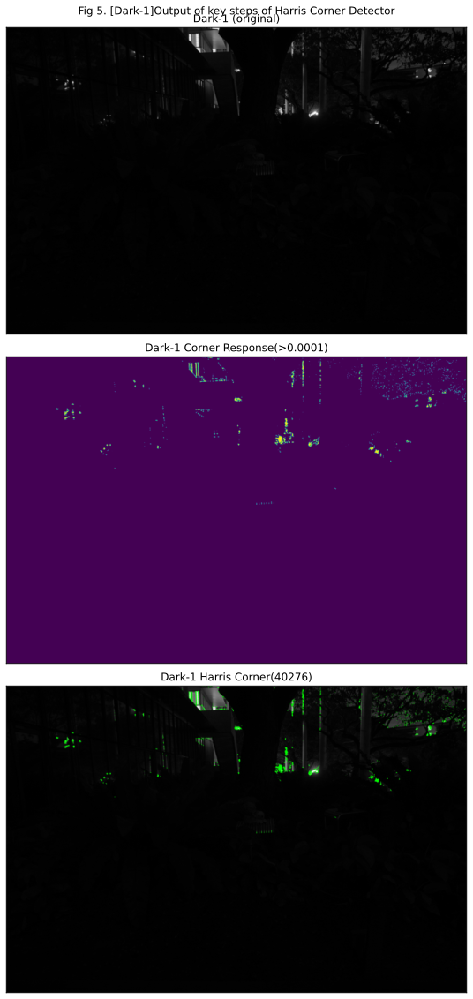

In [3]:
#############################################################################
##                                                                         ##
##           TODO: CODE BLOCK FOR STEP 3 IS HERE                           ##
#############################################################################

# Step 3. Perform Harris Corner Detection (using grayscale image)
from scipy import ndimage
from skimage.data import brick

# Read images and convert to grayscale:
gray_b = cv.imread('res_img/GT1_G.png', cv.IMREAD_GRAYSCALE)
gray_d = cv.imread('res_img/Pic1_G.png', cv.IMREAD_GRAYSCALE)

# Define Sobel kernels Kx, Ky
Kx = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
Ky = Kx.T
# Define the threshold for R and parameter k for calculating R
thresh = 0.0001
k = 0.05
# calculate the corner response: 
# R = ((Ix^2*Iy^2)-IxIy^2) - k(Ix^2+Iy^2)^2, 
# where k is an empirically determined constant between 0.04-0.06
def corner_response(image, k=0.05):
    # Compute first derivatives Ix, Iy
    Ix = signal.convolve2d(image, Kx, boundary='symm', mode='same')
    Iy = signal.convolve2d(image, Ky, boundary='symm', mode='same')
    # Gaussian Filter to reduce noise
    g_kernel=gaussian_kernel(5, 6)
    A = signal.convolve2d(np.square(Ix), g_kernel, boundary='symm', mode='same')
    B = signal.convolve2d(np.square(Iy), g_kernel, boundary='symm', mode='same')
    C = signal.convolve2d(np.multiply(Ix, Iy), g_kernel, boundary='symm', mode='same')
    # Compute corner response at all pixels
    R = (np.multiply(A,B)-np.square(C))-k*np.square(A + B)
    return R
    
R = corner_response(gray_b, 0.05)
R_d = corner_response(gray_d, 0.05)

# Apply non-maximum suppresion
def non_maximum_sup(image_input, R, thersh = 0.005):
    image_out = np.dstack((image_input,image_input, image_input))
    corner_count = 0
    max_Value = thersh*R.max()
    for row_n,row in enumerate(R):
        for col_n,col in enumerate(row):
            if col > max_Value:
                corner_count += 1
                image_out[row_n,col_n] = [0,255,0] 
            else: 
                pass
    return image_out, corner_count

image_out, corner_num = non_maximum_sup(gray_b, R, thresh)
image_out_d, corner_num_d = non_maximum_sup(gray_d, R_d, thresh)

# Save
cv.imwrite('res_img/Bright-1-Harris.png', image_out)
cv.imwrite('res_img/Dark-1-Harris.png', image_out_d)

# Plot
fig_height = (fixed_width * aspect_ratio * 3)

fig, ax = plt.subplots(3, 1, figsize=(fixed_width,fig_height))
fig.suptitle('Fig 4. [Bright-1]Output of key steps of Harris Corner Detector', size = 12)
ax[0].imshow(gray_b, cmap='gray'),    ax[0].set_title('Bright-1 (original)')
ax[1].imshow(R>thresh*R.max()),       ax[1].set_title(f'Corner Response(>{thresh})')
ax[2].imshow(image_out),              ax[2].set_title('Harris Corner('+str(corner_num)+')')
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.show()

fig, ax = plt.subplots(3, 1, figsize=(fixed_width,fig_height))
fig.suptitle('Fig 5. [Dark-1]Output of key steps of Harris Corner Detector', size = 12)
ax[0].imshow(gray_d, cmap='gray'),    ax[0].set_title('Dark-1 (original)')
ax[1].imshow(R_d>thresh*R_d.max()),   ax[1].set_title(f'Dark-1 Corner Response(>{thresh})')
ax[2].imshow(image_out_d),            ax[2].set_title('Dark-1 Harris Corner('+str(corner_num_d)+')')
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.show()

[**Fill in your discussion to Step 3 here**]

<big>**Discussion:**</big>

The Harris Corner Detector performs significantly differently between Bright-1 and Dark-1.<br>

**1. The results of Harris Corners:**<br>
**$\bullet$ Bright-1:** The Harris Corner Detector is able to capture more corners in the image, especially in the upper right section. Areas with strong response have sharp edges or high contrast. The number of corners is significantly larger than *<u>Dark-1</u>*, even using the same threshold for corner response.<br>
**$\bullet$ Dark-1:** The corner response is sparse and weak. In this ultra-dark image, only a very small number of areas produce corner response larger than the threshold.

**2. Reason Analysis:**<br>
**$\bullet$ Brightness and contrast:**<br>
&emsp;The Harris Corner Detector relies on gradient change in the image. The sharper the details and the greater the contrast, the more corners can be detected. Therefore, in the *<u>Dark-1</u>* image, most pixels are close to black, and the gradient is small, leading to few detected corners. 
*<u>Bright-1</u>* has a noticeable contrast, especially at the edges of plants and buildings, which are areas where the corner detector is able to work effectively.

##### **Step 4: Implement histogram equalization from scratch to Dark-1**

In the **first step** of Task 1, the image histogram of Dark-1 has been computed. `y_dark` is the image histogram of Dark-1 in step 1, with which we can compute the **cdf** function.<br>
The **probability** of an occurrence of a pixel of level $i$ in the image is:
$${\displaystyle \ p_{x}(i)=p(x=i)={\frac {n_{i}}{n}},\quad 0\leq i<L}$$
The **cumulative distribution functio**n(cdf) corresponding to $i$ as:
$$ {\displaystyle \operatorname {cdf} _{x}(i)=\sum _{j=0}^{i}p_{x}(x=j)}, $$
The **histogram equalization**(HE) formula is:
$${\displaystyle h(v)=\mathrm {round} \left({\frac {\operatorname {cdf} (v)-\operatorname {cdf} _{\min }}{(M\times N)-\operatorname {cdf} _{\min }}}\times (L-1)\right)}$$
where $\operatorname{cdf}_{\min}$ is the minimum **non-zero** value of the cumulative distribution function, $M × N$ gives the image's number of pixels (where $M$ is width and $N$ is height) and $L$ is the number of grey levels used (in this case, 256).<br>
The HE algorithm is applied in grayscale image:

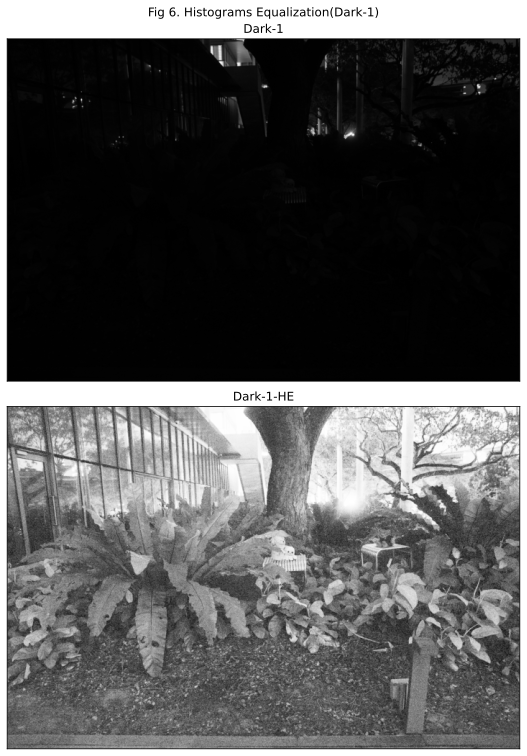

In [4]:
#############################################################################
##                                                                         ##
##           TODO: CODE BLOCK FOR STEP 4 IS HERE                           ##
#############################################################################

# Step 4. Implement Histogram Equalization (HE) from scratch to Dark-1
# 1. Compute cdf:
cdf = y_dark.cumsum()

# 2. Apply HE:
cdf_normalized = ((cdf - cdf.min()) * 255) / (cdf.max() - cdf.min())
gray_d_HE = cdf_normalized[gray_d.flatten()]
gray_d_HE = np.reshape(gray_d_HE, gray_d.shape)
gray_d_HE = gray_d_HE.astype(np.uint8)

# Save
cv.imwrite('res_img/Dark-1-HE.png', gray_d_HE)

# Plot
fig_height = (fixed_width * aspect_ratio * 2)
fig, ax = plt.subplots(2, 1, figsize=(fixed_width, fig_height))
fig.suptitle('Fig 6. Histograms Equalization(Dark-1)', size = 12)
ax[0].imshow(gray_d, cmap='gray'),    ax[0].set_title('Dark-1')
ax[1].imshow(gray_d_HE, cmap='gray'),    ax[1].set_title('Dark-1-HE')
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.show()

[**Fill in your discussion to Step 4 here**]

<big>**Discussion:**</big>

**1.Observation:**<br>
&emsp;After histogram equalization, the *<u>brightness*</u> of the image is significantly improved and the *<u>contrast*</u> of the whole image is enhanced, and more details become clearly visible. <br>
&emsp;Histogram equalization *<u>evenly distributes</u>* the pixel values across the image by *<u>reassigning the luminance values*</u> of the pixels, extending the pixels that were originally concentrated in the lower brightness range to *<u>a wider range</u>* of brightness. As a result, the dark part in the image becomes brighter, while the highlights remain moderately contrasting.<br>
&emsp;While the contrast is enhanced, the HE algorithm also *<u>amplifies noise*</u>, and the noise appears as graininess across the entire image.

**2.Hypothesis:**<br>
**$\bullet$ Canny Edge Detection:**<br> Canny edge detector will identify more edges than the original Dark-1, especially along the boundaries of objects like leaves, branches, building edges, and other strong-intensity gradients in the image. <br>
**$\bullet$ Harris Corner Detection:**<br> The algorithm will detect a greater number of corners due to more visible intensity variations at sharp junctions or texture transitions, like windows in the building, the edges of plant leaves, and so on, which were previously hidden in the dark areas. <br>
However, the *<u>amplified noise*</u> could cause false detection, identifying corners where there aren’t significant structural changes.

##### **Step 5: Apply Canny edge detection and Harris corner detection onto Dark-1-HE**

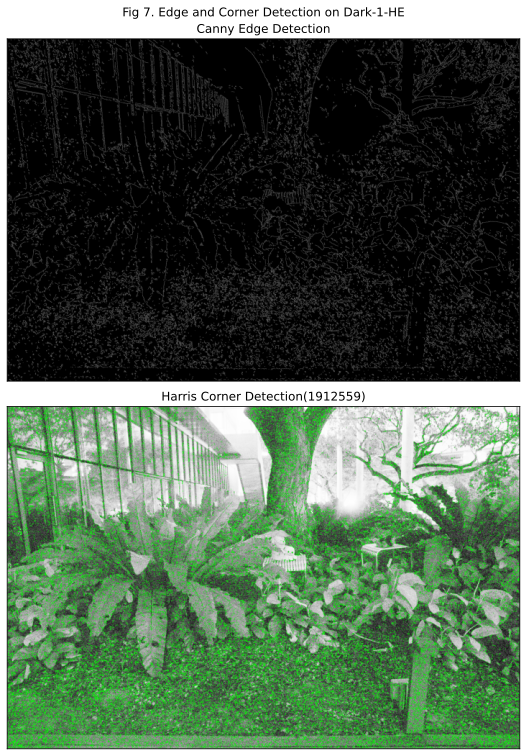

In [5]:
#############################################################################
##                                                                         ##
##           TODO: CODE BLOCK FOR STEP 5 IS HERE                           ##
#############################################################################
# 1. Define function of Canny edge detection:
def Canny_dege(image_in, kernel_size = 5, sigma = 1, low_th_r = 0.05, high_th_r = 0.15):
    gray_im = image_in.copy()
    g_kernel = gaussian_kernel(kernel_size, sigma)
    blur = signal.convolve2d(gray_im, g_kernel, boundary='symm', mode='same')
    gradient, theta, Gx, Gy = sobel_filter(blur)
    nms = non_maximum_suppression(gradient, theta, Gx, Gy)
    thresh = double_threshold(nms, low_th_r, high_th_r)
    res_im = hysteresis(thresh)
    return res_im

# 2. Define function of Harris corner detection
def Harris_corner(image_in, k =0.05, thresh=0.1):
    gray_im = image_in.copy()
    Resp = corner_response(gray_im, k)
    image_out, corner_num = non_maximum_sup(gray_im, Resp, thresh)
    return image_out, corner_num

# 3. Apply Canny edge detection and Harris corner detection on Dark-1-HE
canny_dark_he = Canny_dege(gray_d_HE, 7, 2, 0.15, 0.35)
harris_dark_he, corner_num = Harris_corner(gray_d_HE, 0.05, 0.1)

# Save
cv.imwrite('res_img/Dark-1-HE-Canny.png', canny_dark_he)
cv.imwrite('res_img/Dark-1-HE-Harris.png', harris_dark_he)

# Plot
fig_height = (fixed_width * aspect_ratio * 2)
fig, ax = plt.subplots(2, 1, figsize=(fixed_width, fig_height))
fig.suptitle('Fig 7. Edge and Corner Detection on Dark-1-HE', size = 12)
ax[0].imshow(canny_dark_he,cmap='gray'),    ax[0].set_title('Canny Edge Detection')
ax[1].imshow(harris_dark_he),               ax[1].set_title('Harris Corner Detection('+str(corner_num)+')')
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.show()

[**Fill in your discussion to Step 5 here**]

<big>**Discussion:**</big>

**1.Demonstration:**<br>
The actual outputs fit the previous hypothesis:<br>
$\bullet$ Canny edge detection does detect more edges in *<u>Dark-1-HE</u>* due to its higher contrast, but also captures more noise. The noise impacted the performance, meaning both real and noise-induced edges have been detected, making the result less clean.<br>
$\bullet$ Similarly, Harris corner detection detects more corners in *<u>Dark-1-HE</u>*, but at the cost of introducing false detections from noise.

**2.Comparison:**<br>
The *<u>Bright-1</u>*, with its smoother intensity transitions and lower noise, produces cleaner, more accurate edges and corners, albeit with fewer detected features.

##### **Step 6: Image Enhancement**
&emsp;A single equalization method may not be able to handle all the problems of an image (e.g., noise, low contrast, uneven brightness, etc.) simultaneously, so a *<u>combination</u>* of image enhancement techniques can be used, such as applying *<u>noise reduction</u>* first, followed by *<u>histogram equalization</u>*, and then using *<u>gamma correction</u>* to further fine-tune the brightness of the image. This approach combines the strengths of each technology to improve the overall visual quality of the image.<br>

**1.Bilateral filtering denoising:** <br>
&emsp;It can reduce unwanted noise very well while keeping edges fairly sharp.<br>
&emsp;Use <mark>cv.bilateralFilter(src, d, sigmaColor, sigmaSpace[, dst[, borderType]])</mark><br>
&emsp;*<u>Parameters:</u>*<br>
&emsp;`Sigma values`: For simplicity, you can set the 2 sigma values to be the same. If they are small (< 10), the filter will not have much effect, whereas if they are large (> 150), they will have a very strong effect, making the image look "cartoonish".<br>
&emsp;`Filter size`: Large filters (d > 5) are very slow, so it is recommended to use d=5 for real-time applications, and perhaps d=9 for offline applications that need heavy noise filtering.<br>

**2.CLAHE - Contrast Limited Adaptive Histogram Equalization**<br>
&emsp;To avoid amplifying noise, in this method, the image is divided into small blocks called "tiles" where histogram would confine and contrast limiting is applied. If any histogram bin is above the specified contrast limit, those pixels are clipped and distributed uniformly to other bins before applying histogram equalization. After equalization, to remove artifacts in tile borders, bilinear interpolation is applied.<br>
&emsp;Use <mark>cv.createCLAHE([, clipLimit[, tileGridSize]])</mark><br>
&emsp;*<u>Parameters:</u>*<br>
&emsp;`clipLimit`: Threshold for contrast limiting.<br>
&emsp;`tileGridSize`: Size of grid for histogram equalization. Input image will be divided into equally sized rectangular tiles. tileGridSize defines the number of tiles in row and column.<br>

**3.Gamma correction**<br>
&emsp;Gamma correction can be used to correct the brightness of an image by using a nonlinear transformation between the input values and the mapped output values:
$$ O = (\frac{I}{255})^{\gamma}\times 255$$
&emsp;When $\gamma<1$, the original dark regions will be brighter and the histogram will be shifted to the right whereas it will be the opposite with $\gamma>1$.

In [6]:
#############################################################################
##                                                                         ##
##           TODO: CODE BLOCK FOR STEP 6 IS HERE                           ##
#############################################################################
# Split 3 channels and apply CLAHE respectively and then merge them 
def CLAHE(denoised_img, clipLimit = 4.0, tileGridSize=(8,8)):
    b,g,r = cv.split(denoised_img)
    clahe = cv.createCLAHE(clipLimit, tileGridSize)
    b_eq = clahe.apply(b)
    g_eq = clahe.apply(g)
    r_eq = clahe.apply(r)
    bgr_eq_img = cv.merge((b_eq, g_eq, r_eq))
    return bgr_eq_img

# Auto adjust brightness and contrast by calculate the histogram and apply linear transitions
def auto_adjust_brightness_contrast(image, clip_hist_percent=1):
    gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
    # Calculate histogram and accumulate
    hist = cv.calcHist([gray], [0], None, [256], [0, 256])
    hist_size = len(hist)
    accumulator = np.cumsum(hist)
    # Find the percentage of the histogram in the cumulative histogram
    maximum = accumulator[-1]
    clip_hist_percent *= (maximum / 100.0)
    clip_hist_percent /= 2.0
    # Find the start and end range of a cumulative histogram
    minimum_gray = 0
    while accumulator[minimum_gray] < clip_hist_percent:
        minimum_gray += 1
    maximum_gray = hist_size - 1
    while accumulator[maximum_gray] >= (maximum - clip_hist_percent):
        maximum_gray -= 1
    # Compute alpha and beta
    alpha = 255 / (maximum_gray - minimum_gray)
    beta = -minimum_gray * alpha
    # Apply linear transitions, adjust contrast and brightness
    auto_result = cv.convertScaleAbs(image, alpha=alpha, beta=beta)
    return auto_result

# Gamma correction
def gammaCorrection(img_original, gamma):
    lookUpTable = np.empty((1,256), np.uint8)
    for i in range(256):
        lookUpTable[0,i] = np.clip(pow(i / 255.0, gamma) * 255.0, 0, 255)
    res = cv.LUT(img_original, lookUpTable)
    return res

# Bilateral filtering denoising
denoised_img = cv.bilateralFilter(img_dark, d=3, sigmaColor=75, sigmaSpace=75)
# CLAHE
bgr_eq_img = CLAHE(denoised_img, 4.2, (8,8))
# Auto adjust brightness and contrast
contrast_adjusted = auto_adjust_brightness_contrast(bgr_eq_img)
# Gamma correction
gamma_img = gammaCorrection(contrast_adjusted, 0.50)
# Gaussian Blur (denoising)
k_size = 3
output_img = cv.GaussianBlur(gamma_img, (k_size, k_size), sigmaX = 1)

# Save Dark-1-Self
cv.imwrite('res_img/Dark-1-Self.png', output_img)

# Plot
fig_height = (fixed_width * aspect_ratio * 5)*1.04
fig, ax = plt.subplots(5, 1, figsize=(fixed_width, fig_height))
fig.suptitle('Fig 8. Image Enhancement on Dark-1', size = 12)
ax[0].imshow(cv.cvtColor(img_dark, cv.COLOR_BGR2RGB)),              ax[0].set_title('Dark-1')
ax[1].imshow(cv.cvtColor(denoised_img, cv.COLOR_BGR2RGB)),          ax[1].set_title('Bilateral filtering denoising')
ax[2].imshow(cv.cvtColor(bgr_eq_img, cv.COLOR_BGR2RGB)),            ax[2].set_title('CLAHE')
ax[3].imshow(cv.cvtColor(contrast_adjusted, cv.COLOR_BGR2RGB)),     ax[3].set_title('Contrast and Brightness Adjustment')
ax[4].imshow(cv.cvtColor(output_img, cv.COLOR_BGR2RGB)),            ax[4].set_title('Gamma correction (Dark-1-Self)')
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.subplots_adjust(top=0.96)
plt.show()

/var/folders/6x/w4vd6dz97bg0d1jlg5pf0xcr0000gn/T/ipykernel_25299/2259337201.py:98: RuntimeWarning: invalid value encountered in double_scalars
  x_est = np.abs(Gy[i,j]/Gmag[i,j]) # y


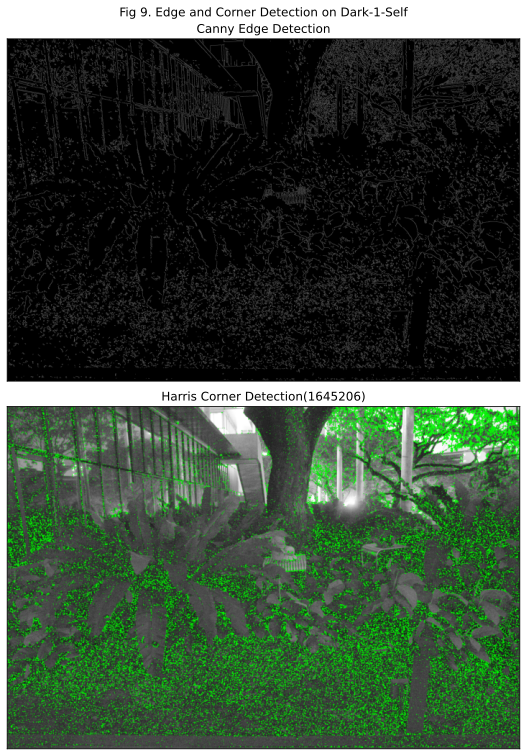

In [7]:
# Convert to grayscale
gray_self = cv.cvtColor(src=output_img, code=cv.COLOR_BGR2GRAY)

# Apply Canny edge detection and Harris corner detection on Dark-1-Self
canny_dark_self = Canny_dege(gray_self, 7, 2, 0.002, 0.15)
harris_dark_self, corner_num = Harris_corner(gray_self, 0.05, 0.001)

# Save result
cv.imwrite('res_img/Dark-1-Self-Canny.png', canny_dark_self)
cv.imwrite('res_img/Dark-1-Self-Harris.png', harris_dark_self)

# Plot
fig_height = (fixed_width * aspect_ratio * 2)
fig, ax = plt.subplots(2, 1, figsize=(fixed_width, fig_height))
fig.suptitle('Fig 9. Edge and Corner Detection on Dark-1-Self', size = 12)
ax[0].imshow(canny_dark_self,cmap='gray'),    ax[0].set_title('Canny Edge Detection')
ax[1].imshow(harris_dark_self),               ax[1].set_title('Harris Corner Detection('+str(corner_num)+')')
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.show()

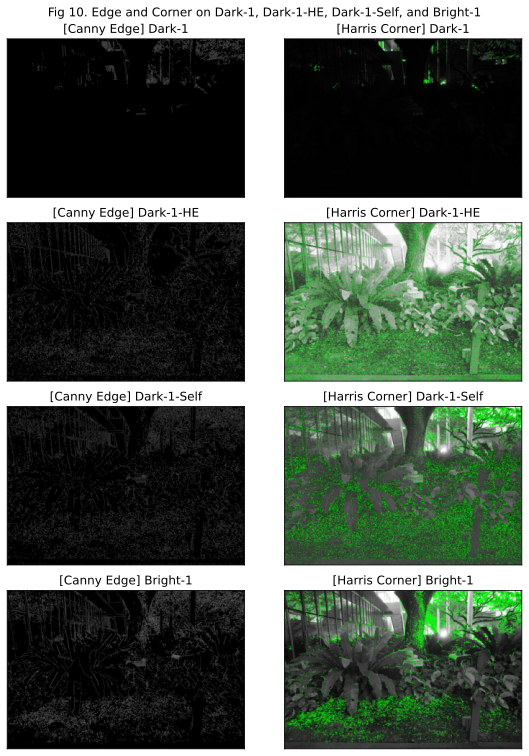

In [8]:
# Show the result of Canny Edge detection on Bright-1 and Dark-1-HE
dark_1_canny = cv.imread('res_img/Dark-1-Canny.png')
he_canny = cv.imread('res_img/Dark-1-HE-Canny.png')
self_canny = cv.imread('res_img/Dark-1-Self-Canny.png')
bright_1_canny = cv.imread('res_img/Bright-1-Canny.png')
dark_1_harris = cv.imread('res_img/Dark-1-Harris.png')
he_harris = cv.imread('res_img/Dark-1-HE-Harris.png')
self_harris = cv.imread('res_img/Dark-1-Self-Harris.png')
bright_1_harris = cv.imread('res_img/Bright-1-Harris.png')

# Plot
fig_height = (fixed_width/2 * aspect_ratio * 4)
fig, ax = plt.subplots(4, 2, figsize=(fixed_width, fig_height))
fig.suptitle('Fig 10. Edge and Corner on Dark-1, Dark-1-HE, Dark-1-Self, and Bright-1', size = 12)
ax[0,0].imshow(dark_1_canny,cmap='gray'),  ax[0,0].set_title('[Canny Edge] Dark-1')
ax[1,0].imshow(he_canny,cmap='gray'),      ax[1,0].set_title('[Canny Edge] Dark-1-HE')
ax[2,0].imshow(self_canny,cmap='gray'),    ax[2,0].set_title('[Canny Edge] Dark-1-Self')
ax[3,0].imshow(bright_1_canny,cmap='gray'),ax[3,0].set_title('[Canny Edge] Bright-1')
ax[0,1].imshow(dark_1_harris),             ax[0,1].set_title('[Harris Corner] Dark-1')
ax[1,1].imshow(he_harris),                 ax[1,1].set_title('[Harris Corner] Dark-1-HE')
ax[2,1].imshow(self_harris),               ax[2,1].set_title('[Harris Corner] Dark-1-Self')
ax[3,1].imshow(bright_1_harris),           ax[3,1].set_title('[Harris Corner] Bright-1')
for i in range(ax.shape[0]):
    for j in range(ax.shape[1]):
        ax[i,j].set_xticks([])
        ax[i,j].set_yticks([])
plt.tight_layout()
plt.show()

[**Fill in your discussion to Step 6 here**]

<big>**Discussion**</big>

**1.Dark-1-Self VS Dark-1-HE:**<br>
$\bullet$ Canny Edge Detection: <br>
*<u>Dark-1-HE</u>*: The edges appear cluttered and fragmented, and areas that were slightly brighter in Dark-1 are now **overexposed**, with outlines indistinguishable, such as the staircase area and the utility poles, but the rest of the darker detail is restored, albeit with a lot of edges caused by amplified noise.<br>
*<u>Dark-1-Self</u>*: The edges are much cleaner than in Dark-1-HE, although the noise could not be removed during the image enhancement process to achieve the cleaner result in Bright-1, the edges of the elements are basically found, the brightness around the stairs and the poles is well restored and not overexposed, and the edges of the dolls and the table are much more clearly defined, with the overall result being much closer to that of Bright-1.<br>

$\bullet$ Harris Corner Detection: <br>
*<u>Dark-1-HE</u>*: Due to the presence of a lot of amplified noise in the enhanced image, this leads to many misjudged corners, which are located in locations where no real structural changes occur. For example, the surface of the column in the lower right corner, where no corner point should appear. These misjudged points cause us to lose sight of many objects, such as dolls and bushes. Similar to the Canny Edge Detection results, the **overexposed** portion of the equalized image has no corners found.<br>
*<u>Dark-1-Self</u>*: The enhanced image also has noise interference, but the noise inside the leaves, the pillar in the lower right corner, and other parts of the image are still suppressed, so the number of misjudged corners is less compared to Dark-1-HE. Meanwhile, the contrast and brightness after equalization are relatively appropriate, there is no large overexposure, and the details of the staircase part are well preserved.<br>

**2.Dark-1 and Bright-1:**<br>
$\bullet$ Canny Edge Detection: <br>
*<u>Bright-1</u>*: The edges are clean and well-structured, with the edges of all the elements in the image visible: tree trunks, poles, foliage, the ground, the glass wall, the table and dolls in the bushes, and the area of the staircase where the brightness is higher.<br>
*<u>Dark-1</u>*: The edges are drastically reduced, and only the upper half of the frame is still bright enough to see the outline of the staircase and the texture of the leaves in the upper right corner.<br>

$\bullet$ Harris Corner Detection: <br>
*<u>Bright-1</u>*: Corners are mainly concentrated in tree branches, leaves, buildings, the ground, dolls and chairs, and other locations with large gradient changes;
There are no corners to be found in areas with little intensity change, such as on the surface of the blades, poles in the upper right corner and the post in the lower right corner. The overall contrast is decent, and the corners are relatively clean.<br>
*<u>Dark-1</u>*: Corners are only focused on the parts with lights or sky background, and a lot of details are lost due to the lack of contrast.<br>

<br><br>

#### Before Task 2
- For the following task, you are to use [GT1](https://canvas.nus.edu.sg/files/4601732/download?download_frd=1) (denote as Bright-1) and [GT2](https://canvas.nus.edu.sg/files/4601734/download?download_frd=1) (denote as Bright-2) as the stereo image pair.
- All raw images are given in RGB format (colored images), but you may also convert to grayscale images for your convenience. Show the step and result of grayscale conversion first if you are to convert to grayscale for your tasks.
- You may opt to resize the images in case you think the image is too large, the resize images **must not** be smaller than **800*800**. Show the step and result of resize first if you opt to resize the images.
- **IMPORTANT!** You may use any function of OpenCV or its equivalence for basic operations (e.g., loading images, matrix computation, etc.), but **strictly NOT** the direct functions for each individual task/step (e.g., cv.computeCorrespondEpilines for computing and drawing the epipolar lines and cv.findFundamentalMat for computing the fundamental matrix). Using such functions would consider the code to be erroneous.

#### Task 2: Computing the Fundamental Matrix and Finding the Epipolar Lines for Stereo Image Pairs (40%)
In this task, you will need to compute the fundamental matrix based on the (Normalized) 8-point algorithm. You are to choose the keypoints manually (you can use tools such as Paint for Windows), and then compute the fundamental matrix. You would then find, draw out, observe and discuss about the epipolar lines for your chosen keypoints. You are to follow the following steps (requirements):

##### Steps/Requirements for Task 2:
1. Find and highlight the keypoints in the image manually. For the 8-point algorithm, you should select at least 8 non-colinear points. State the individual positions in **homogeneous** coordinates, and highlight them in the corresponding image. If you choose to use the normalized 8-pt algorithm, you should state the coordinates of both the original keypoints and the normalized keypoints and showcase your code for normalization, but you only need to highlight the original keypoints. If you find highlighting in the pixel level is difficult, you may use a small circle centered at the selected keypoint for highlighting. (10%)
2. With the selected keypoints, compute the fundamental matrix *F* in detail. State the obtained fundamental matrix. (10%)
3. With the fundamental matrix, draw all the epipolar lines corresponding to the selected keypoints on both images. Observe and discuss how these lines indicate the positioning of the cameras. Also discuss if the computed lines match your intuitive idea of how the lines should be formed. If yes, why? If no, why not? (10%)
4. Lastly, with the computed fundamental matrix, we would be also able to find the epipolar line and subsequently the corresponding keypoint given a new keypoint. Select a **new** keypoint that does not lie on any of the drawn epipolar lines on Bright-1, then draw the epipolar line corresponding to this new keypoint on Bright-2. Observe and discuss if a possible keypoint can be obtained by searching across the drawn epipolar line. (10%)

##### **Step 1: Select Manually and Normalize 8 Keypoint Pairs**
&emsp;The coordinates in each image are translated to bring the centroid of the set of all points to the origin independently. Afterward, the coordinates are scaled so that the average distance of a point $p$ from the origin is equal to $\sqrt{2}$.
The following steps have to be done for each frame:<br>
$\bullet$ Translation:
$$ t_x = \frac{1}{N}\sum_{i=1}^{N}p_{x,i},\quad\quad\quad\quad t_y = \frac{1}{N}\sum_{i=1}^{N}p_{y,i}
$$
where $t=(t_x,t_y)$ is the centroid or "center of mass" of the $k = 1,...,N$ points $p_k^i$ in the accoding frame.<br>
Then center the points by:
$$ mc = p_i - t$$
$\bullet$ Scaling: The distance of each new calculated point to the origin (0,0) is defined by:
$$ dc = \sqrt{\sum{(mc)^2}}$$
$dc$ divided by the number of tracked points, results in the average distance ($\overline{dc}$) to the origin. <br>
To satisfy the criteria that the average distance of a point $p$ from the origin is equal to $\sqrt{2}$, we have to apply a scale factor $s$.
$$s=\frac{\sqrt{2}}{\overline{dc}}$$
The normalized data can be computed by applying the transformation matrix:
$$
T = \begin{bmatrix}
s & 0 & -s \cdot c_x \\
0 & s & -s \cdot c_y \\
0 & 0 & 1
\end{bmatrix}
$$
Normalized point $q_i$ can be computed by:  $ q_i = Tp_i$

After we get the Fundamental Matrix $\hat{F}_{q}$, we have to adjust the result to undo the effect of the normalization.
$$ F = T^{T}\hat{F}_{q}T^{\prime} $$

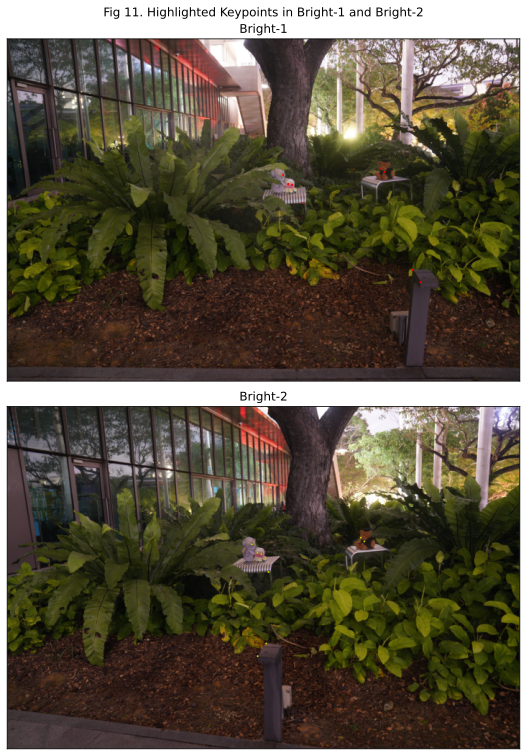

KeyboardInterrupt: 

In [13]:
#############################################################################
##                                                                         ##
##           TODO: CODE BLOCK FOR STEP 1 IS HERE                           ##
#############################################################################
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# Load images
img1 = cv.imread('ori_img/GT1.jpg')
img2 = cv.imread('ori_img/GT2.jpg')
img1_rgb = cv.cvtColor(img1, cv.COLOR_BGR2RGB)
img2_rgb = cv.cvtColor(img2, cv.COLOR_BGR2RGB)
# Select 8 points from the first image manually:
kp1 = np.array([[2184, 1126],[2214, 1133],[2144, 1056],[2907, 1004],[2930, 1032],[3148, 1792],[2302, 1273],[3211, 1888]], dtype=np.uint32)
kp2 = np.array([[1944, 1136],[1974, 1144],[1902, 1068],[2748, 1017],[2775, 1046],[2013, 1838],[2031, 1284],[1946, 1937]], dtype=np.uint32)

# Highlight in both images
fixed_width = 8
height, width, channel = img1.shape
aspect_ratio = height / width 
fig_height = (fixed_width * aspect_ratio*2)
fig, ax = plt.subplots(2,1, figsize=(fixed_width, fig_height))
fig.suptitle('Fig 11. Highlighted Keypoints in Bright-1 and Bright-2', size = 12)
ax[0].imshow(img1_rgb),                 ax[0].set_title('Bright-1')
ax[1].imshow(img2_rgb),                 ax[1].set_title('Bright-2')
for (x, y) in kp1:
    ax[0].plot(x, y, 'ro', markersize=1)
for (x, y) in kp2:
    ax[1].plot(x, y, 'yo', markersize=1)
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.show()

def normalize_points(pts):
    # Convert the points to numpy array
    pts = np.array(pts, dtype = np.float32)
    # Compute centroid
    centroid = np.mean(pts, axis=0)
    # Compute average distance from centroid
    distances = np.sqrt(np.sum((pts - centroid)**2, axis=1))
    mean_dist = np.mean(distances)
    # Scale factor to make mean distance sqrt(2)
    scale = np.sqrt(2) / mean_dist   
    # Create normalization matrix T
    T = np.array([[scale, 0, -scale * centroid[0]],
                  [0, scale, -scale * centroid[1]],
                  [0, 0, 1]])
    # Normalize points
    pts_homo = np.hstack([pts, np.ones((pts.shape[0], 1))])
    pts_normalized = (T @ pts_homo.T).T
    return pts_homo,pts_normalized[:, :2], T  # Return normalized points and transformation matrix

# Normalize the selected points
pts_homo1, norm_points1, T1 = normalize_points(kp1)
pts_homo2, norm_points2, T2 = normalize_points(kp2)

# Print normalized points
print("Original Keypoints 1(Homogeneous coordinates):", pts_homo1)
print("Original Keypoints 2(Homogeneous coordinates):", pts_homo2)
print("Normalized Keypoints 1:", norm_points1)
print("Normalized Keypoints 2:", norm_points2)

[**Fill in your discussion to Step 1 here**]

<big>**Discussion:**</big>

I concentrate the 8 points in a relatively small area so that when normalized, the distance between the points from the center will be more balanced.<br>
Most of the keypoints are picked from the dolls(the nose of the purple bear, eyes of the octopus, and nose of the brown bear), one from the left chair and two from the pole in the front of the scene.

##### **Step 2: Compute Fundamental Matrix**
With the epipolar constraint: $p^TFp^{\prime} = 0 $, we have $Wf=0$: 
$$\left[
\begin{matrix}
uu',uv',u,vu',vv',v,u',v',1
\end{matrix}
\right] \left[
\begin{matrix}
F_{11}\\
F_{12}\\
F_{13}\\
F_{21}\\
F_{22}\\
F_{23}\\
F_{31}\\
F_{32}\\
F_{33}
\end{matrix}
\right] = 0
$$
Solve for $F$ using SVD:<br>
$$F = U\left[
\begin{matrix}
s1 & 0 & 0 \\
0  & s2& 0 \\
0  & 0 & 0
\end{matrix}
\right]V^T
$$
The solution $f$ that minimizes $\lVert Wf \rVert$ is the right sigular vector corresponding to the smallest singular value of $W$. It is the last column of $V$ in the SVD of $W$.
To ensure the rank of $F$ is 2, the smallest singular value of $S$ is removed.<br>
If we use normalized coordinates $q_i = Tp_i$ and ${q}_i^{\prime} = T^{\prime}p_i^{\prime}$ to calculate $\hat{F_q}$, then we can get the denormalized $F$ by:
$$ F = T^{T}\hat{F}_{q}T^{\prime} $$

In [10]:
#############################################################################
##                                                                         ##
##           TODO: CODE BLOCK FOR STEP 2 IS HERE                           ##
#############################################################################
def compute_fundamental_matrix(pts1, pts2):
    n = len(pts1)
    A = []
    for i in range(n):
        x1, y1 = pts1[i]
        x2, y2 = pts2[i]
        A.append([x1*x2, x1*y2, x1, y1*x2, y1*y2, y1, x2, y2, 1])
    A = np.array(A)
    # Perform SVD on A
    U, S, Vt = np.linalg.svd(A)
    # The fundamental matrix is the last column of V
    F = Vt[-1].reshape(3, 3)
    # Constrain F to rank 2 by performing SVD and setting the smallest singular value to zero
    U, S, Vt = np.linalg.svd(F)
    S[-1] = 0
    F = U @ np.diag(S) @ Vt
    return F

# Compute the fundamental matrix with normalized points
F_normalized = compute_fundamental_matrix(norm_points1, norm_points2)
print("Normalized Fundamental Matrix F_norm:\n", F_normalized)

# Denormalize the fundamental matrix
F = T1.T @ F_normalized @ T2

# Print the fundamental matrix
print("Fundamental Matrix F:\n", F)

Normalized Fundamental Matrix F_norm:
 [[ 4.50592962e-04  3.06179242e-03  1.20463558e-02]
 [ 3.32872914e-02  1.55869594e-02  7.61395839e-01]
 [ 1.75542764e-02 -6.46814405e-01  1.78542954e-03]]
Fundamental Matrix F:
 [[ 3.91755372e-09  2.66198926e-08 -1.03616790e-05]
 [ 2.89406988e-07  1.35516432e-07  1.27917392e-03]
 [-3.27287340e-04 -2.29956184e-03  9.50113148e-01]]


[**Fill in your discussion to Step 2 here**]

<big>**Discussion:**</big>

The Fundamental Matrix $F$ is solved by performing SVD. 
$$ 
F = \left[
\begin{matrix}
3.91755372e-09 & 2.66198926e-08 & -1.03616790e-05 \\
2.89406988e-07 & 1.35516432e-07 & 1.27917392e-03  \\
-3.27287340e-04 & -2.29956184e-03  & 9.50113148e-01
\end{matrix}
\right]
$$

##### **Step 3: Draw Epipolar Lines**
The epipolar line $l$(Bright-1) associated with $p'$(Bright-2) is: $l=Fp'$.<br>
The epipolar line $l'$(Bright-2) associated with $p$(Bright-1) is: $l'=F^Tp$.<br>



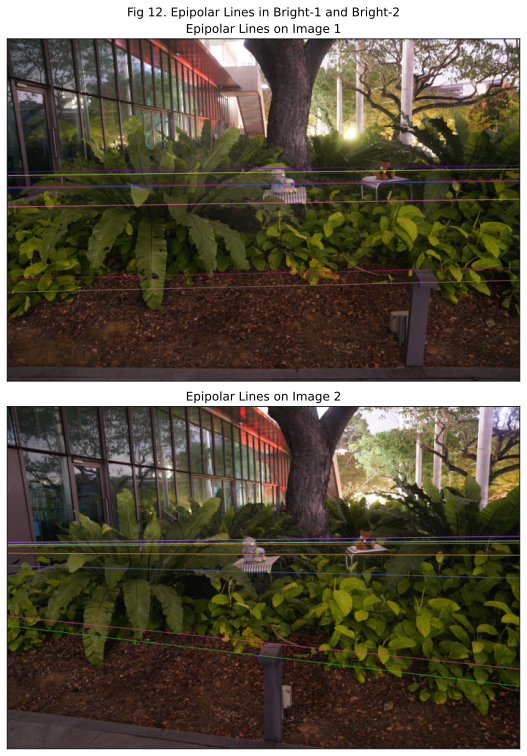

In [11]:
#############################################################################
##                                                                         ##
##           TODO: CODE BLOCK FOR STEP 3 IS HERE                           ##
#############################################################################
def draw_epipolar_lines(F, pts_other, img):
    # Compute the epipolar lines in one image for each point in the other image
    lines = np.dot(F, np.hstack([pts_other, np.ones((pts_other.shape[0], 1))]).T).T
    # Normalize the lines
    lines = lines / np.sqrt(lines[:, 0]**2 + lines[:, 1]**2)[:, np.newaxis]
    # Draw lines on the image
    img_copy = img.copy()
    for r in lines:
        color = tuple(np.random.randint(0, 255, 3).tolist())
        x0, y0 = map(int, [0, -r[2] / r[1]])
        x1, y1 = map(int, [img_copy.shape[1], -(r[2] + r[0] * img_copy.shape[1]) / r[1]])
        img_copy = cv.line(img_copy, (x0, y0), (x1, y1), color, 3) # epipolar line
    return img_copy

# Draw epipolar lines on both images
img1_with_lines = draw_epipolar_lines(F, kp2, img1)         # Epipolar lines in image 1 for points in image 2
img2_with_lines = draw_epipolar_lines(F.T, kp1, img2)       # Epipolar lines in image 2 for points in image 1

# Display images with epipolar lines
fixed_width = 8
fig_height = (fixed_width * aspect_ratio*2)
fig, ax = plt.subplots(2,1, figsize=(fixed_width, fig_height))
fig.suptitle('Fig 12. Epipolar Lines in Bright-1 and Bright-2', size = 12)
# Plot manually picked points
for pt1, pt2 in zip(kp1, kp2):
    color = tuple(np.random.randint(0, 255, 3).tolist())
    img1_copy = cv.circle(img1_with_lines, tuple(np.array(pt1).astype(int)), 10, color, -1)
    img2_copy = cv.circle(img2_with_lines, tuple(np.array(pt2).astype(int)), 10, color, -1) 
ax[0].imshow(cv.cvtColor(img1_with_lines, cv.COLOR_BGR2RGB)), ax[0].set_title('Epipolar Lines on Image 1')
ax[1].imshow(cv.cvtColor(img2_with_lines, cv.COLOR_BGR2RGB)), ax[1].set_title('Epipolar Lines on Image 2')
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.show()
# Save results:
cv.imwrite('res_img/Epipolar_line_GT1.png', img1_copy)
cv.imwrite('res_img/Epipolar_line_GT2.png', img2_copy);

[**Fill in your discussion to Step 3 here**]

<big>**Discussion:**</big>

**1. Camera Positioning:**<br>
&emsp;The epipolar lines indicate converging cameras(shown in the following picture).<br>
![Converging Cameras](image.png)
&emsp;The direction in which the epipolar lines converge is the epipole, and the epipole is located on the line connecting the current camera origin and the other camera origin.<br>
&emsp;From <u>*Bright-2*</u> we can see that the epipole is located on the left side, which indicates that camera 2 has moved to the right relative to camera 1.<br>
&emsp;Moreover, camera 2 is not oriented parallel to camera 1. Otherwise, the situation shown in the figure below would occur: the epipolar lines in both images are parallel to each other.
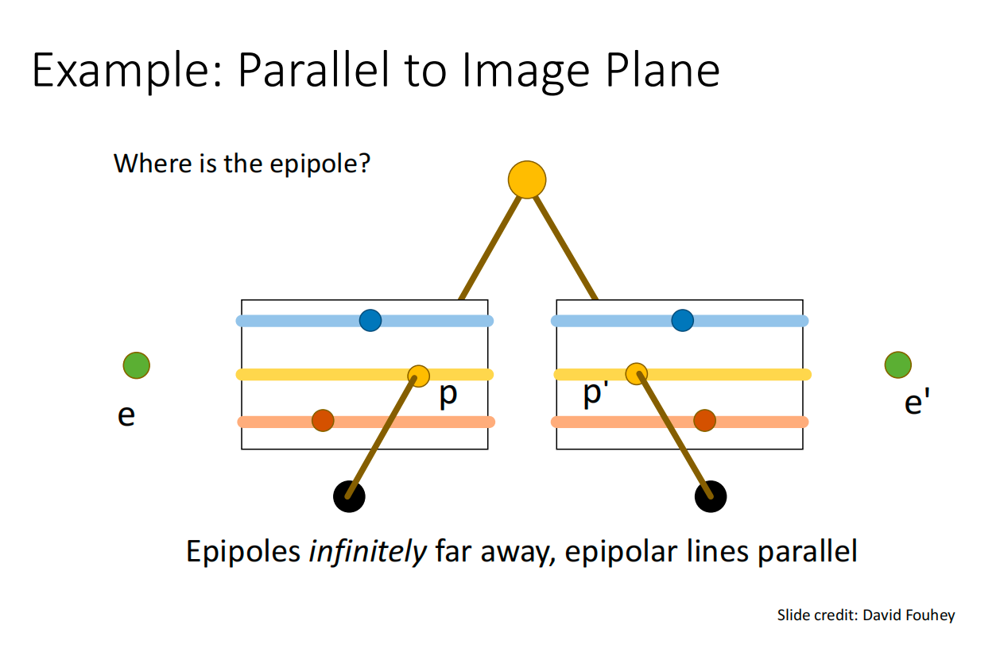
&emsp;So we can determine that camera 2 is rotated to the left relative to camera 1 so that the epipolar lines of <u>*Bright-2*</u> converge on the left side of the frame.<br>

**2. Intuitive Idea:**<br>
&emsp;The computed lines match my intuitive idea of how the lines should be formed.<br>
&emsp;From the two frames, the position of the second camera origin is shifted to the right relative to the first and the camera direction is rotated to the left by a certain angle. <br>
&emsp;All epipolar lines should point to the epipoles(shown in the following pictures):
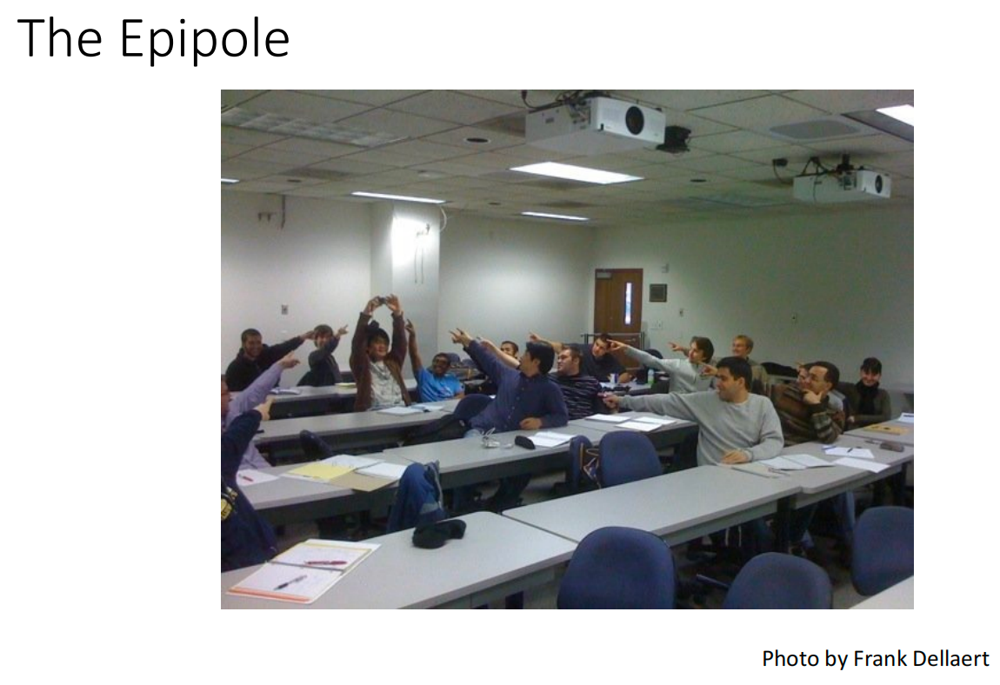
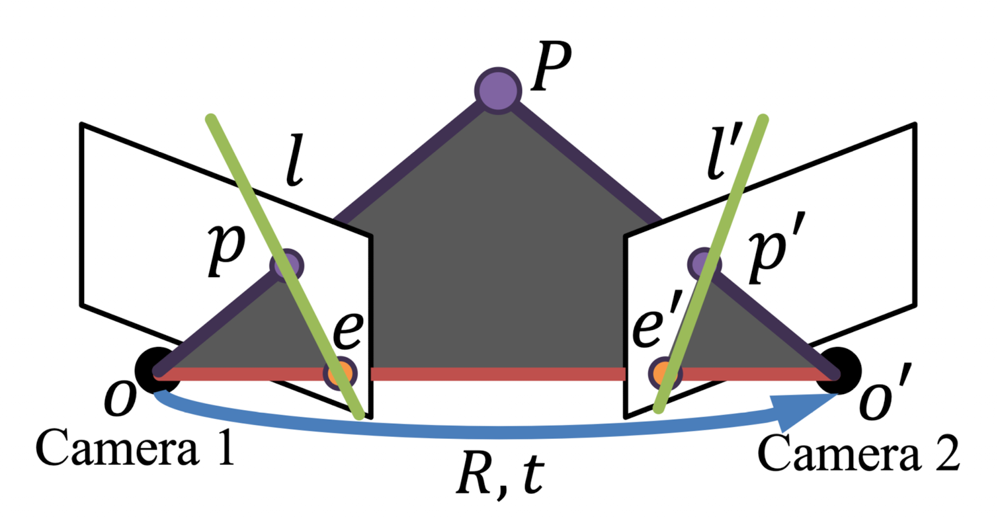

##### **Step 4: Find The Epipolar Line And The Corresponding Keypoint Given A New Keypoint**

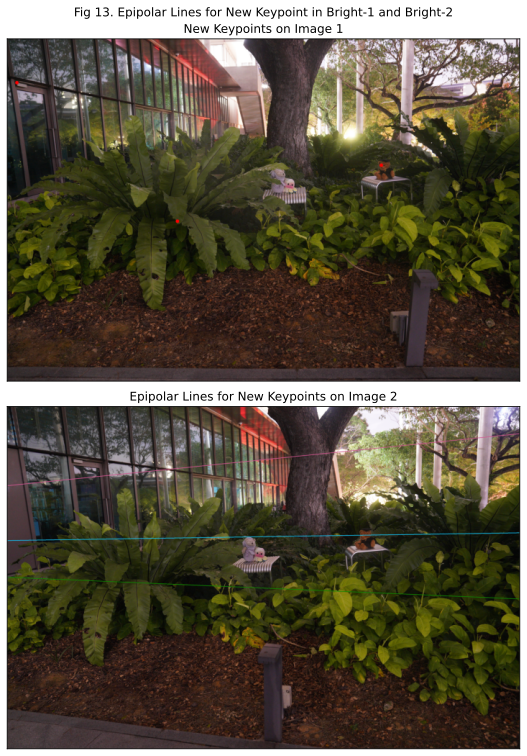

In [12]:
#############################################################################
##                                                                         ##
##           TODO: CODE BLOCK FOR STEP 4 IS HERE                           ##
#############################################################################

# Pick 3 new keypoints in image 1 (manually)
new_point_1 = np.array([[75, 342], [2904, 982],[1321, 1416]], dtype = np.float32)

# Compute and draw the new epipolar line on image 2
img2_with_new_line = draw_epipolar_lines(F.T, new_point_1, img2)

# Display images with epipolar lines
fig_height = (fixed_width * aspect_ratio*2)
fig, ax = plt.subplots(2,1, figsize=(fixed_width, fig_height))
fig.suptitle('Fig 13. Epipolar Lines for New Keypoint in Bright-1 and Bright-2', size = 12)
# Highlight the three new points
for float_pt in new_point_1:
    int_point = tuple(float_pt.round().astype(int))
    img1_newpt = cv.circle(img1, int_point, 3, (0,0,255), 20)
ax[0].imshow(cv.cvtColor(img1_newpt, cv.COLOR_BGR2RGB)),        ax[0].set_title('New Keypoints on Image 1')
ax[1].imshow(cv.cvtColor(img2_with_new_line, cv.COLOR_BGR2RGB)),ax[1].set_title('Epipolar Lines for New Keypoints on Image 2')
for i in range(ax.shape[0]):
    ax[i].set_xticks([])
    ax[i].set_yticks([])
plt.tight_layout()
plt.show()
# Save results:
cv.imwrite('res_img/New_Points_GT1.png', img1_newpt)
cv.imwrite('res_img/New_Points_GT2.png', img2_with_new_line);

[**Fill in your discussion to Step 4 here**]

<big>**Discussion:**</big>

**1.Observation:**<br>
&emsp;I chose 3 new points(<u>marked in the Bright-1 with red dot </u>): one point is the corner of the door frame, which is located at the upper left edge of the frame; another point is at the right eye of the brown bear, which is close to one of the 8 points previously chosen but does not cross any existing epipolar lines; and the third point is a small hole in the leaf located in the center of the frame.<br>
&emsp;The epipolar line results I obtained are shown in the figure. The epipolar line corresponding to the keypoint in the upper left corner failed to find the corresponding keypoint and had a relatively large error, the second epipolar line crossed the corresponding key point on the bear's eye quite accurately, and the third epipolar line was close to the correct key point, but did not cross it accurately.

**2.Reason:**<br>
&emsp;We obtained three matching results, which represent three different levels of accuracy. Here are some possible reasons and my analysis:<br>
**$\bullet$ Selection of keypoints:** <br>
The accuracy of the fundamental matrix is highly dependent on the selected keypoints. For the calculation of $F$, the selected points need to be distributed in the image as much as possible and try to avoid co-linearity. If the selected keypoints are concentrated or close to co-linear, the calculated fundamental matrix may be inaccurate, which leads to the deviation of the epipolar line.<br>
**$\bullet$ Noise and Error:** <br>
There is a certain amount of noise and error in the localization of keypoints. If the keypoints are not precise (since we picked them manually), these errors may be amplified during the computation of the fundamental matrix, resulting in inaccurate final epipolar lines.<br>
**$\bullet$ Non-ideal keypoint position:**<br>
When selecting keypoints, if the point pairs are selected to be keypoints near the edge of the image, these points may lead to instability in the fundamental matrix computation due to factors such as imaging aberrations(in other words, these points don't consistent with those points located in the ideal position and used to calculate the fundamental matrix), which in turn affects the position of the epipolar line.<br>
**$\bullet$ Increase the number of keypoint pairs:**<br>
Although the 8-point algorithm is the most basic method, the robustness of the fundamental matrix can be improved by adding more pairs of keypoints (e.g., 15-20 pairs) and using the cv.RANSAC method to make the epipolar lines more accurate.<br>